<center>
<h3>YES ! 🎉🎉🎉 This is a Colab version of the...</h3>
<h1>Antarctic 3D Maps using the IBCSO version 2 and PyGMT</h1>
</center>

**Very Important Note**: The Google Colaboratory, or just *colab*,  is a hosted Jupyter notebook service using a *free of charge* environment to computing resources including GPUs. The Python version changes all the time, as PyGMT does too. So, we have to install everything from scratch, but to do that you need exactly the time to make a good coffee. So click on the install block below, make yourself a nice cup of coffee, and when you're done it's ready for you to program.  

In this tutorial, let's use PyGMT with the brand new [International Bathymetric Chart of the Southern Ocean](https://ibcso.org/) Version 2 (IBCSO v2) from [Dorschel, B et al. (2022)](https://doi.pangaea.de/10.1594/PANGAEA.937574?format=html#download), to show you some of the most beautiful Antarctic gateways. 😉

You can change or adapt the scripts for your own use, always remembering to reference the IBCSO as the data source. If you're not already using PyGMT, just get started now (!). This is an excellent way to create your own beautiful maps.

However, if you're in a hurry, just send me a private message and I can try to adapt some of the examples for you (depending on the free time I have).

Let's start ?!

## Start here, and go to make a coffee during installation...

You just need to run this block below and during the next 2-3 minutes it will install the full GMT in your COLAB Virtual Machine. Just remember that when you log out, the VM disappears. So if you want to make changes and save them, I advise you to copy this notebook to your google drive.

**Note**: your session will crash, but it's normal (!). Just keep going....


In [1]:
!pip install -q condacolab
import condacolab
condacolab.install()

⏬ Downloading https://github.com/conda-forge/miniforge/releases/download/23.11.0-0/Mambaforge-23.11.0-0-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:17
🔁 Restarting kernel...


In [ ]:
%%capture
!mamba install pygmt #<- note qwe use mamba but you can do it with conda

In [2]:
# and if you don't believe in it
!gmt --version
!python --version

6.5.0
Python 3.10.13


## First of all, the data

The International Bathymetric Chart of the Southern Ocean Version 2 (IBCSO v2) is a digital bathymetric model (DBM) with a resolution of 500 m × 500 m in a polar stereographic projection (EPSG: 9354). In fact, you don't need to worry too much about it as 'PyGMT' can easily recognize the geographic grid. The first step is to download the data from PANGAEA, in particular the two grids [IBCSO_v2_ice-surface_WGS84.nc](https://download.pangaea.de/dataset/937574/files/IBCSO_v2_ice-surface_WGS84.nc) and [IBCSO_v2_bed_WGS84.nc](https://download.pangaea.de/dataset/937574/files/IBCSO_v2_bed_WGS84.nc).

The difference between the two is that the **ice-surface** contains the topography in meters including the glaciers and the **bed**, the subglacial bed reck elevation. In case you are looking for the map of the entire Southern Ocean, the [PDF distributed](https://download.pangaea.de/dataset/937574/files/IBSCO_v2_digital_chart.pdf) by the IBCSO is fantastic.

Please, download both files to the same location where you downloaded this jupyter notebook.

In [3]:
# for the colab version, we use the 'wget' to the these data
!wget https://download.pangaea.de/dataset/937574/files/IBCSO_v2_ice-surface_WGS84.nc
!wget https://download.pangaea.de/dataset/937574/files/IBCSO_v2_bed_WGS84.nc

--2024-07-24 20:15:45--  https://download.pangaea.de/dataset/937574/files/IBCSO_v2_ice-surface_WGS84.nc
Resolving download.pangaea.de (download.pangaea.de)... 134.1.2.172
Connecting to download.pangaea.de (download.pangaea.de)|134.1.2.172|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 254366080 (243M) [application/octet-stream]
Saving to: ‘IBCSO_v2_ice-surface_WGS84.nc’

IBCSO_v2_ice-surfac 100%[===================>] 242.58M  22.5MB/s    in 11s     

2024-07-24 20:15:58 (21.1 MB/s) - ‘IBCSO_v2_ice-surface_WGS84.nc’ saved [254366080/254366080]

--2024-07-24 20:15:58--  https://download.pangaea.de/dataset/937574/files/IBCSO_v2_bed_WGS84.nc
Resolving download.pangaea.de (download.pangaea.de)... 134.1.2.172
Connecting to download.pangaea.de (download.pangaea.de)|134.1.2.172|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 254366072 (243M) [application/octet-stream]
Saving to: ‘IBCSO_v2_bed_WGS84.nc’

IBCSO_v2_bed_WGS84. 100%[=============

The next block is just a few routines to facilitate the work. Note that for some maps, we will create a custom color map with the [GMT color pallete](https://docs.generic-mapping-tools.org/latest/cookbook/cpts.html#built-in-color-palette-tables-cpt) tables 'abyss', for depths and 'gray' for elevation.

In [4]:
# a small function to help with depth limits
import math
def truncate_down(n):
    return(math.floor(n/100)*100)

def truncate_up(n):
    return(math.ceil(n/100)*100)

# create a custom colormap for some maps
def create_custom_cpt(min_depth,max_depth):

    # set limits for depth
    min_d = truncate_down(min_depth)
    max_d = truncate_down(max_depth)

    # create the colormap
    bathy_cpt = pygmt.makecpt(cmap='abyss',output='bathy.cpt',series=f'{min_d}/0/50',continuous=True)
    topo_cpt = pygmt.makecpt(cmap='gray',output='topo.cpt',series=f'0/{max_d}/50')

    with open('bathy.cpt') as f:
        contents_bathy = f.readlines()
    with open('topo.cpt') as f:
        contents_topo = f.readlines()

    # merge colormap
    with open('combo.cpt', 'w') as f:
        f.writelines(contents_bathy[0:-3])
        f.writelines(contents_topo)

    f.close()
    return

## Second, let's get all the data

Let's use 'xarray' to open the netcdf files. Note in the structure that both data contains a regular grid of 3757 points in latitude and 33812 points in longitude, and that the variable 'z' corresponds to the elevation in meters referring to the current Mean Sea Level.

In [5]:
import xarray as xr

dset_bed = xr.open_dataset('IBCSO_v2_bed_WGS84.nc',decode_coords='all')
dset_ice = xr.open_dataset('IBCSO_v2_ice-surface_WGS84.nc',decode_coords='all')

# as an example
dset_ice

<xarray.Dataset> Size: 508MB
Dimensions:  (lat: 3757, lon: 33812)
Coordinates:
    crs      |S1 1B ...
  * lat      (lat) float64 30kB -90.0 -89.99 -89.97 ... -50.03 -50.02 -50.01
  * lon      (lon) float64 270kB -180.0 -180.0 -180.0 ... 180.0 180.0 180.0
Data variables:
    z        (lat, lon) float32 508MB ...
Attributes:
    Conventions:      CF-1.5
    title:            International Bathymetric Chart of the Southern Ocean (...
    institution:      Alfred Wegener Institute Helmholtz Centre for Polar and...
    contact:          Dr. Boris Dorschel, IBCSO@awi.de,southern-ocean@seabed2...
    comment:          The International Bathymetric Chart of the Southern Oce...
    doi:              https://doi.pangaea.de/10.1594/PANGAEA.937574
    webpage:          www.ibcso.org
    IBCSO_version:    2.0
    doi_publication:  https://doi.org/10.1038/s41597-022-01366-7

As the focus of this tutorial is on creating maps on the Antarctic Peninsula, let's cut out an area of interest. Note the small difference between 'bed' and 'ice'. The surface of the antarctic icesheets will appear in green (which corresponds to the color scale of the 'geo' palette used).

In [6]:
import pygmt

peninsula = [-70,-50,-71,-60]

AP_bed = pygmt.grdcut(grid=dset_bed.z,region=peninsula,verbose='q')
AP_ice = pygmt.grdcut(grid=dset_ice.z,region=peninsula,verbose='q')

# resample for a resolution of 0.1 km
AP_ice_low=pygmt.grdsample(grid=AP_ice,spacing='0.1+k',verbose='q')

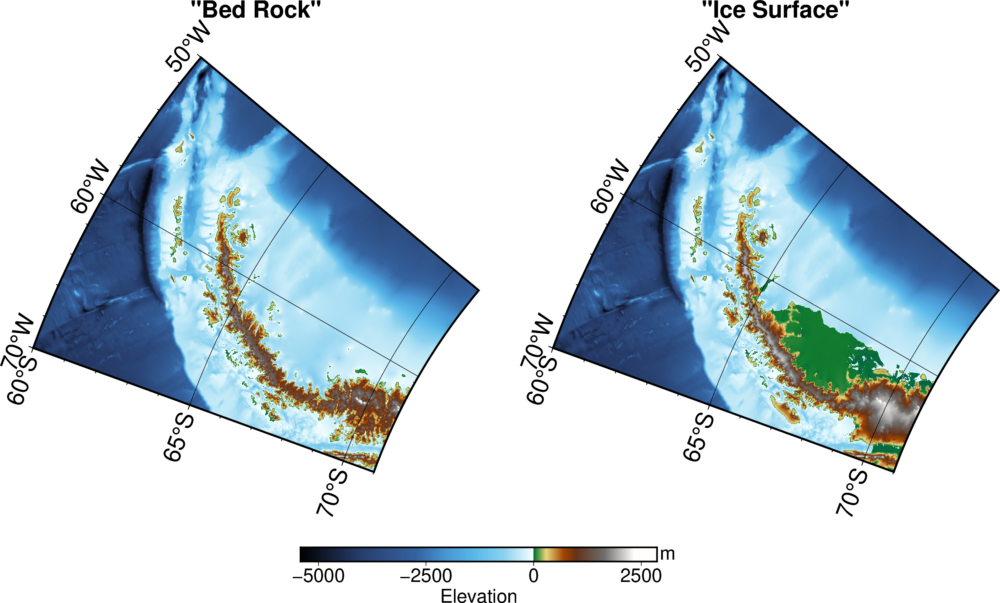

In [10]:
# let's try a comparative map of bed and ice
import pygmt

fig = pygmt.Figure()
# define figure configuration
pygmt.config(FORMAT_GEO_MAP="dddF", MAP_FRAME_TYPE="plain",FONT='18p')

# --------------- plotting the IBCSO bed rock -----------
fig.grdimage(grid=AP_bed,region=peninsula,projection="S0/-90/12c",frame=['xa10g10f','ya5g5f','+t"Bed Rock"'],cmap='geo')

fig.shift_origin(xshift="6c",yshift="-1c")
fig.colorbar(frame=["a2500", "x+lElevation", "y+lm"])

# --------------- plotting the IBCSO ice surface -----------
fig.shift_origin(xshift="8c",yshift="1c")
fig.grdimage(grid=AP_ice,region=peninsula,projection="S0/-90/12c",frame=['xa10g10f','ya5g5f','+t"Ice Surface"'],cmap='geo')

fig.show()

## A 3D map of the Antarctic Peninsula (South Shetland Islands point of view)

The [South Shetland Islands](https://en.wikipedia.org/wiki/South_Shetland_Islands) are a group of Antarctic islands located north of the Antarctic Peninsula, about 850 km southwest of [Cape Horn](https://en.wikipedia.org/wiki/Cape_Horn) (aprox. 463 nm across [Drake Passage](https://en.wikipedia.org/wiki/Drake_Passage)). When crossing this main gateway, any ship will be transiting in deep water (~3000 to 4000 meters deep) and from a geological point of view, the South Shetlands is basically a "huge cliff" that marks the edge of the Antarctic continent, as can be seen seen on this map.

In [11]:
# Note the max and min elevation in the grid
print(f'IBCSO has a minimum depth of {AP_bed.min().values:.1f}'
      f' and maximum of {AP_bed.max().values:.1f} meters relative to sea level.')

IBCSO has a minimum depth of -5414.0 and maximum of 2865.0 meters relative to sea level.


Some notes for the coder:
- as geographically proximity to the pole generates a distortion for a 3D map, here the code chooses to represent the surface in projection [Lambert Conic Conformal](https://www.pygmt.org/dev/projections/conic/conic_lambert.html). Be careful if you want to change this.
- note that the base of the figure is actually geographic north, to demonstrate the huge difference in height.
- the perception of geological features changes with a different shading angle. If you want to change this, I suggest small changes.
- it is possible to note the enormous topographical variability of the Scotia arc, which is the northern edge of the Shetlands.
- The color palette here is 'geo' and that's why the colors look so unreal. Also note that 'grdview' is used with the surface type 'surftype'="s" or "surface".

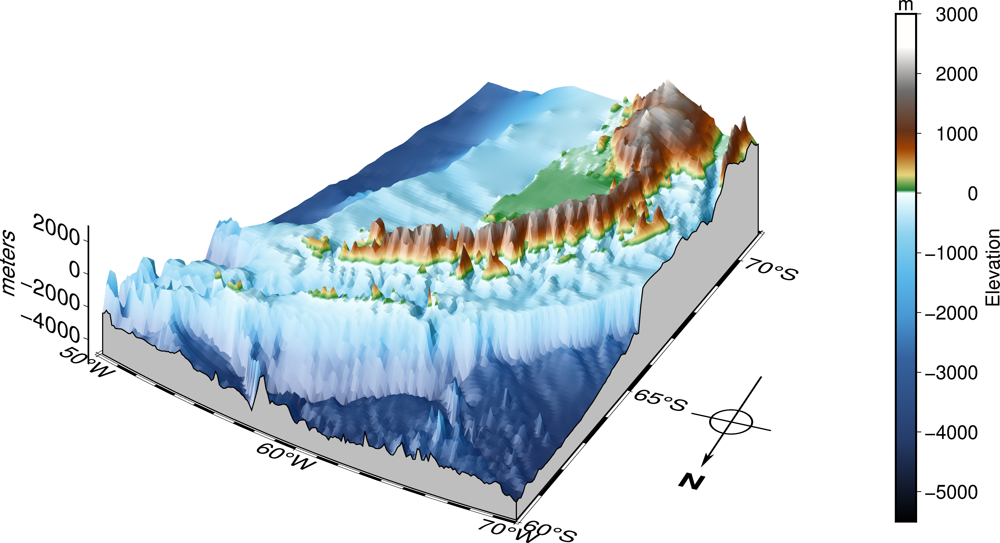

In [13]:
# let's make the figure
fig = pygmt.Figure()

pygmt.config(FORMAT_GEO_MAP="dddF", MAP_FRAME_TYPE="fancy")

# note I can add projection, after cmap and after, frame (and control frame)
topo_cpt = pygmt.makecpt(cmap='geo',series=f'-5500/3000/50',continuous=True)
frame =  ["xa10f1","ya5f1", "z2000+lmeters", "WseNZ"]

with pygmt.config(FONT='22p'):
    fig.shift_origin(xshift='15c')
    fig.grdview(grid=AP_ice_low,
                region=peninsula+[-5500,3000],
                frame=frame,
                perspective=[-35,35], # set the perspective here
                projection='L-60/-65/-72/-60/15c', # set the projection
                zsize='5c',
                surftype='s',
                cmap=topo_cpt,
                plane="-5500+ggrey", # set the plane of the map
                shading='+a20+nt1') # caution with the shading
    fig.basemap(
        perspective=True,
        rose="JCL+w5c+l+o1c/0c" # map directional rose at the center (MAP) left with a little shift
    )

with pygmt.config(FONT='16p'):
    fig.shift_origin(xshift='12c')
    fig.colorbar(frame=["a1000", "x+lElevation", "y+lm"],position='+w15c')

fig.show()

## Deception Island

One of the main highlights for those who sail in the area of the peninsula is [Deception Island](https://en.wikipedia.org/wiki/Deception_Island), known for being an 'almost' quiet natural harbor, and also for its underlying active volcano (yes! active!). From the figure below, it is possible to see that the deep waters of the Bransfield Strait are the result not only of volcanic activity at the edge of the South Shetland Islands Block (SSIB) but also of the separation of the SSIB and the South Orkney microcontinent (SOM) (see details in [Riley et al, 2019](https://www.researchgate.net/publication/334468597_Geochronology_and_geochemistry_of_the_northern_Scotia_Sea_A_revised_interpretation_of_the_North_and_West_Scotia_ridge_junction)).


A few notes for the coder:
- Note that the projection here has been changed as the area is much smaller.
- Arrow indicates geographic north for reference.
- Eventually you can also point out that the volcano of deception has a steeper flank than the other, a result of the hotspot drift over the plate.

In [14]:
deception = [-62.8,-58.5,-63.4,-62.5]

Deception_ice = pygmt.grdcut(grid=dset_ice.z,region=deception,verbose='q')

# Note the max and min elevation in the grid region

deception_min_depth = Deception_ice.min().values
deception_max_depth = Deception_ice.max().values

min_d = truncate_down(deception_min_depth)
max_d = truncate_up(deception_max_depth)

print(f'IBCSO-Deception area has a minimum depth of {deception_min_depth:.1f}'
      f' and maximum of {deception_max_depth:.1f} meters relative to sea level.')

# create a custom colormap for these min max depths
create_custom_cpt(min_d,max_d)

IBCSO-Deception area has a minimum depth of -1666.0 and maximum of 1847.0 meters relative to sea level.


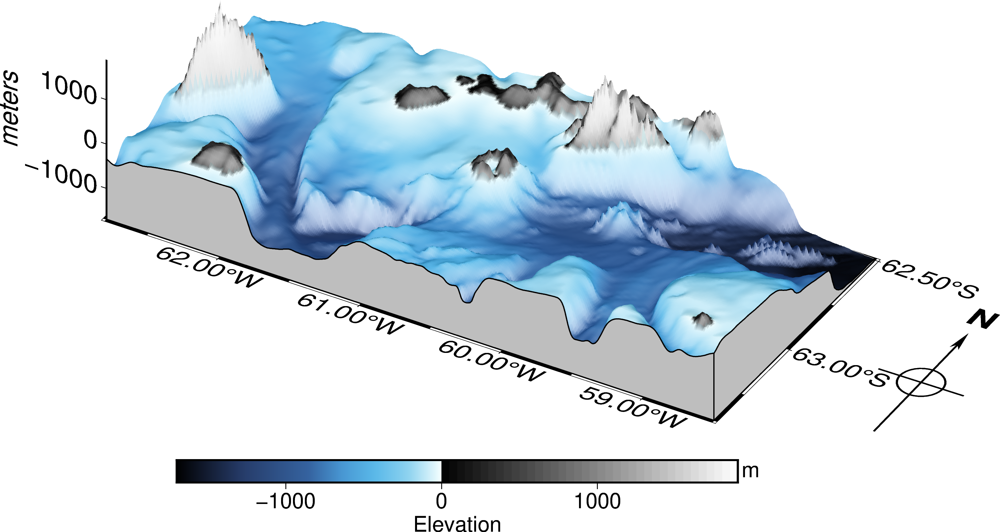

In [15]:
fig = pygmt.Figure()

with pygmt.config(FORMAT_GEO_MAP="ddd.xxF", MAP_FRAME_TYPE="fancy",FONT='22p'):
    fig.grdview(grid=Deception_ice,
                region=deception+[min_d,max_d],
                frame=["xa1f0.5","ya0.5f0.25","z1000+lmeters","wSEnZ"],
                perspective=[150,35], # set the perspective here
                projection='M18c', # projection use is Mercartor
                zsize='5c',
                surftype='i',
                cmap='combo.cpt',
                plane=f"{min_d}+ggrey",
                shading='+a150+nt1')
    fig.basemap(
        perspective=True,
        rose="JCR+w5c+l+o2.5c/0c" # map directional rose at the center (MAP) right with a little shift
    )

with pygmt.config(FONT='16p'):
    fig.colorbar(cmap='combo.cpt',frame=["a1000", "x+lElevation", "y+lm"])

fig.show()


## Gerlache strait

The [Gerlache Strait](https://en.wikipedia.org/wiki/Gerlache_Strait) is a channel that separates the [Palmer Archipelago](https://en.wikipedia.org/wiki/Palmer_Archipelago) (the islands clearly identified on the right side in the map below) from the Antarctic Peninsula (on the map, top left). Note that the geographic north arrow points downwards as this is the best viewing angle for the deep channel in Gerlache. The embayments on the Peninsula are magical places, with fantastic views of peaks that rise up to 2600 m above sea level. Note that we are using 'ice-surface' data here.

Both the deep channel at Gerlache and the northern part of [Anvers Island](https://en.wikipedia.org/wiki/Anvers_Island) were excavated during the last deglaciation.

In [16]:
gerlache = [-64,-61,-65.0,-63.5]
Gerlache_ice = pygmt.grdcut(grid=dset_ice.z,region=gerlache,verbose='q')

# Note the max and min elevation in the grid region

gerlache_min_depth = Gerlache_ice.min().values
gerlache_max_depth = Gerlache_ice.max().values

min_d = truncate_down(gerlache_min_depth)
max_d = truncate_up(gerlache_max_depth)

print(f'IBCSO-Gerlache area has a minimum depth of {gerlache_min_depth:.1f}'
      f' and maximum of {gerlache_max_depth:.1f} meters relative to sea level.')

# create a custom colormap for these min max depths
create_custom_cpt(min_d,max_d)


IBCSO-Gerlache area has a minimum depth of -1413.0 and maximum of 2613.0 meters relative to sea level.


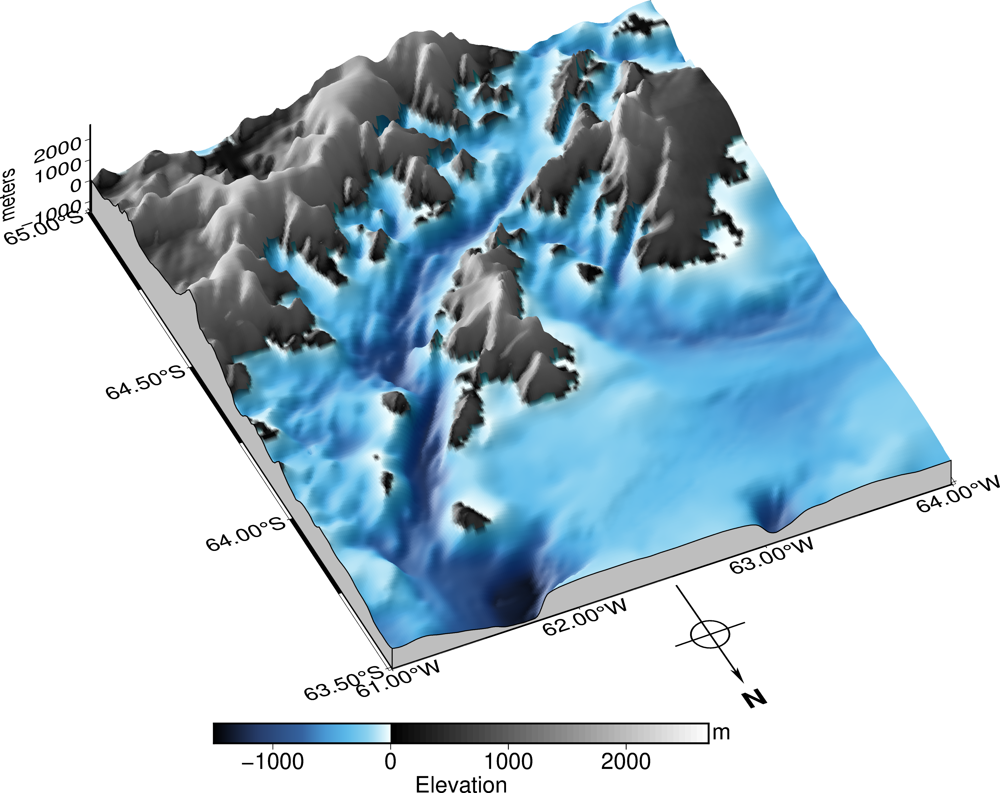

In [17]:
fig = pygmt.Figure()

with pygmt.config(FORMAT_GEO_MAP="ddd.xxF", MAP_FRAME_TYPE="fancy",FONT='22p'):
    fig.grdview(grid=Gerlache_ice,
                region=gerlache+[min_d,max_d],
                frame=["xa1f0.5","ya0.5f0.25","z1000+lmeters","wsENZ"],
                perspective=[25,45], # check the perspective angle
                projection='M20c', # check the projection here
                zsize='4c',
                surftype='i',
                cmap='combo.cpt',
                plane=f"{min_d}+ggrey",
                shading='+a150+nt1')
    fig.basemap(
        perspective=True,
        rose="JTC+w5c+l+o0c/0.5c" # map directional rose at the top (MAP) center with a little shift
    )

with pygmt.config(FONT='20p'):
    fig.shift_origin(xshift='2c',yshift='-1.5c')
    fig.colorbar(cmap='combo.cpt',frame=["a1000", "x+lElevation", "y+lm"])

fig.show()


## Polar Circle

The [Polar Circle](https://en.wikipedia.org/wiki/Antarctic_Circle) is a geographic term for a latitudinal position where the Sun is above the horizon for 24 continuous hours at least once a year (and therefore visible at midnight) after the [Austral Solstice in December](https://en.wikipedia.org/wiki/December_solstice). The exact position of the Antarctic Circle is not fixed (but we can say that it is currently around 66°33′ S.) because its latitude depends on the [Earth's axial tilt](https://en.wikipedia.org/wiki/Astronomical_nutation), which fluctuates within a margin of more than 2° over a period of 41,000 years.

Regardless, it is also a magical mark for those who navigate the waters of the Southern Ocean. The code block below generates the map of the region and marks the current Antarctic Polar Circle in small red dots on the map.

Note to coders:
- With the region of interest configured, we take the maximum and minimum values of longitude and extract the elevations over the latitude of 66°33′ S with the 'grdtrack' function, to a 'pandas' dataframe.
- the points are then plotted on the map as a series of very small red circles using 'plot3d'
- again, pay attention to the geographic north that points to the left and down on the map, due to perspective.
- It is possible to observe that the continental shelf there is very shallow, the result of an intense process of sedimentation driven by glacial forces.

In [18]:
polarcircle = [-67.8,-63.5,-67,-64.5]
Polarcircle_ice = pygmt.grdcut(grid=dset_ice.z,region=polarcircle,verbose='q')

# Note the max and min elevation in the grid region

polarcircle_min_depth = Polarcircle_ice.min().values
polarcircle_max_depth = Polarcircle_ice.max().values

min_d = truncate_down(polarcircle_min_depth)
max_d = truncate_up(polarcircle_max_depth)

print(f'IBCSO-Polar Circle area has a minimum depth of {polarcircle_min_depth:.1f}'
      f' and maximum of {polarcircle_max_depth:.1f} meters relative to sea level.')

# create a custom colormap for these min max depths
create_custom_cpt(min_d,max_d)


IBCSO-Polar Circle area has a minimum depth of -1445.0 and maximum of 2325.0 meters relative to sea level.


In [19]:
# create a track over the polar circle with min & max longitudes (50 dots)

import numpy as np
import pandas as pd

longitude = np.linspace(Polarcircle_ice.lon.min(),Polarcircle_ice.lon.max(),50)
latitude = [-66.5667] * len(longitude)
points = pd.DataFrame(data={'longitude':longitude,'latitude':latitude})

output_PC = pygmt.grdtrack(points=points, grid=Polarcircle_ice, newcolname="z_PC")

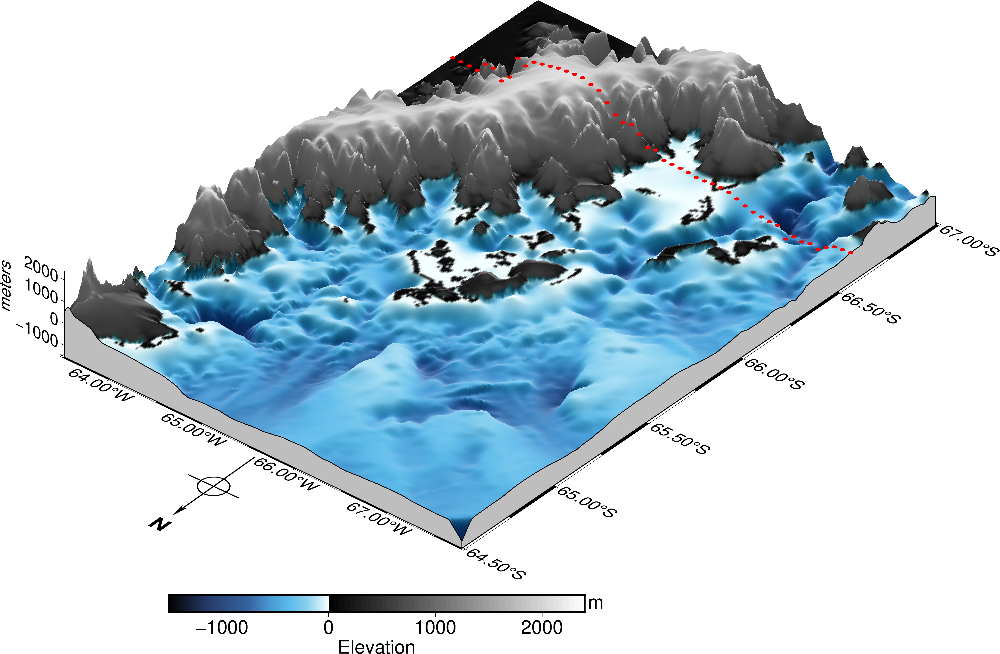

In [21]:
fig = pygmt.Figure()

perspective = [-40,35]
projection = 'M20c'

with pygmt.config(FORMAT_GEO_MAP="ddd.xxF", MAP_FRAME_TYPE="fancy",FONT='22p'):
    fig.grdview(grid=Polarcircle_ice,
                region=polarcircle+[min_d,max_d],
                frame=["xa1f0.5","ya0.5f0.25","z1000+lmeters","WseNZ"],
                perspective=perspective, # note the perspective
                projection=projection, # and projection
                zsize='4c',
                surftype='i',
                cmap='combo.cpt',
                plane=f"{min_d}+ggrey",
                shading='+a150+nt1')
    fig.plot3d(x=output_PC['longitude'], # here we plot the polar circle dots
               y=output_PC['latitude'],
               z=output_PC['z_PC'],
               fill='red',
               style='c0.2c',
               perspective=perspective,
               projection=projection,
              )
    fig.basemap(
        perspective=True,
        rose="JTC+w5c+l+o0c/0.5c" # map directional rose at the top (MAP) center with a little shift
    )

with pygmt.config(FONT='20p'):
    fig.shift_origin(xshift='2c',yshift='-1.5c')
    fig.colorbar(cmap='combo.cpt',frame=["a1000", "x+lElevation", "y+lm"])

fig.show()


## Antarctic Sound

Last but not least, the [Antarctic Sound](https://en.wikipedia.org/wiki/Antarctic_Sound) is a gateway about 30 nautical miles (approx. 56 km) in length and no more than 7 to 12 nautical miles (13 to 22 km) wide and separating the extreme northeast of the Antarctic Peninsula, a passage to the [Wedell Sea](https://en.wikipedia.org/wiki/Weddell_Sea), home of the great icebergs. This passage is also essential for the flow of water between the east and west sides of the peninsula.

In addition to the western tip of [Joinville Island](https://en.wikipedia.org/wiki/Joinville_Island), there is also a group of islands called the [Danger Islands](https://en.wikipedia.org/ wiki/Danger_Islands), a tiny group with almost 1.5 million noisy individuals of [Adélie penguins](https://en.wikipedia.org/wiki/Ad%C3%A9lie_penguin). This is one of the most special places (among many!) in this passage between Bransfield and the Weddell Sea, where history and nature mix.

Note to coders:
- here the perspective is at 45°, and north points up and to the right. You can see in the upper part of the map the great canyons of the tip of the peninsula, a result of intense glaciation in the past, as well as on the left side, the channel that separates [James Ross Island](https://en.wikipedia.org/ wiki/James_Ross_Island) from the mainland.
- This is the map with the smallest variation in topography (from -1825.0 to a maximum of 1640.0 meters relative to sea level)

In [22]:
antarctic_sound = [-59,-54.5,-64.5,-62.5]
Antarctic_sound_ice = pygmt.grdcut(grid=dset_ice.z,region=antarctic_sound,verbose='q')

# Note the max and min elevation in the grid region

antarctic_sound_min_depth = Antarctic_sound_ice.min().values
antarctic_sound_max_depth = Antarctic_sound_ice.max().values

min_d = truncate_down(antarctic_sound_min_depth)
max_d = truncate_up(antarctic_sound_max_depth)

print(f'IBCSO-Antarctic Sound area has a minimum depth of {antarctic_sound_min_depth:.1f}'
      f' and maximum of {antarctic_sound_max_depth:.1f} meters relative to sea level.')

# create a custom colormap for these min max depths
create_custom_cpt(min_d,max_d)


IBCSO-Antarctic Sound area has a minimum depth of -1814.0 and maximum of 1640.0 meters relative to sea level.


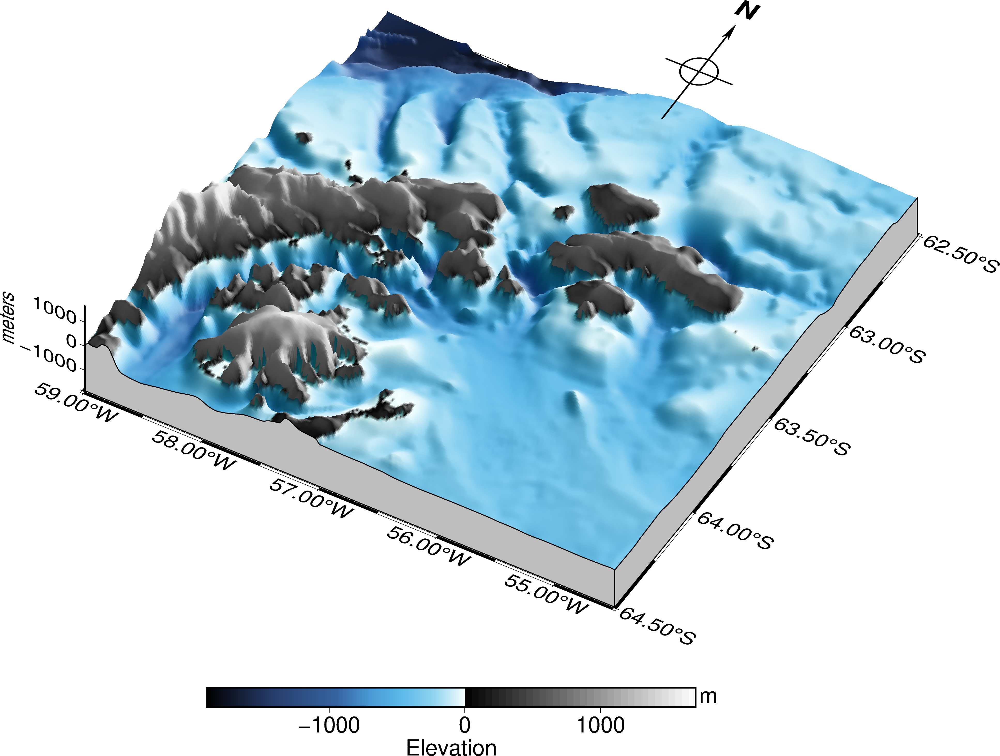

In [23]:
fig = pygmt.Figure()

with pygmt.config(FORMAT_GEO_MAP="ddd.xxF", MAP_FRAME_TYPE="fancy",FONT='22p'):
    fig.grdview(grid=Antarctic_sound_ice,
                region=antarctic_sound+[min_d,max_d],
                frame=["xa1f0.5","ya0.5f0.25","z1000+lmeters","wSEnZ"],
                perspective=[150,45],
                projection='M20c',
                zsize='4c',
                surftype='i',
                cmap='combo.cpt',
                plane=f"{min_d}+ggrey",
                shading='+a25+nt1')
    fig.basemap(
        perspective=True,
        rose="JTC+w5c+l+o0c/0.5c" # map directional rose at the top (MAP) center with a little shift
    )

with pygmt.config(FONT='20p'):
    fig.shift_origin(xshift='2c',yshift='-1.5c')
    fig.colorbar(cmap='combo.cpt',frame=["a1000", "x+lElevation", "y+lm"])

fig.show()


That is all ! I hope you enjoyed it and that you can learn a lot from this tutorial. You can still learn by customizing your maps or creating your plots, with more pygmt tutorials at:
- Tutorials at https://www.pygmt.org/v0.6.1/tutorials/index.html
- Gallery examples at https://www.pygmt.org/v0.6.1/gallery/index.html

And if any questions arise along the way, you have the entire community of users on your side in the PyGMT forum at https://forum.generic-mapping-tools.org/c/questions/pygmt-q-a/11.

If you're still not confident with 'python' or 'pygmt', if want some special map (and if I can help) or if you find some bug here, just drop me a message via the GitHub repository at https://github.com/andrebelem/AntarcticMaps or by email to [andrebelem@id.uff.br](mailto:andrebelem@id.uff.br).

Enjoy!